Extracting all the keypoints from the training data

In [ ]:
import cv2
import mediapipe as mp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve, auc
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense, Dropout 
from tensorflow.keras.utils import to_categorical

In [3]:
# Initialize MediaPipe Hands
mp_hands = mp.solutions.hands
hands = mp_hands.Hands(static_image_mode=True, min_detection_confidence=0.7)

# Dataset directory (UPDATE THIS PATH)
DATASET_DIR = r'C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train'

# Initialize lists to store extracted data
landmark_data = []
labels = []

# Listing all folders (A-Z, space, delete, nothing)
class_labels = os.listdir(DATASET_DIR)

# Process each folder (each letter class)
for label in class_labels:
    folder_path = os.path.join(DATASET_DIR, label)
    
    if not os.path.isdir(folder_path):
        continue 

    # Process each image in the folder
    for file in os.listdir(folder_path):
        if file.endswith(".png") or file.endswith(".jpg"): 
            img_path = os.path.join(folder_path, file)

            
            image = cv2.imread(img_path)

            # Check if image is valid
            if image is None:
                print(f"❌ ERROR: Failed to load {file}")
                continue

            print(f"🔍 Processing: {file} | Class: {label}")

            # Convert image to RGB (MediaPipe requires RGB)
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Process image with MediaPipe
            print(f"Processing {img_path}")
            results = hands.process(image_rgb)
            
            if results.multi_hand_landmarks:
                print("Hand detected!")
            else:
                print("No hand detected.")

            # If a hand is detected, extract landmarks
            if results.multi_hand_landmarks:
                for hand_landmarks in results.multi_hand_landmarks:
                    # Extract landmark points (x, y, z) for 21 keypoints
                    landmarks = np.array([[lm.x, lm.y, lm.z] for lm in hand_landmarks.landmark]).flatten()

                    # Save data
                    landmark_data.append(landmarks)
                    labels.append(label)
                    print(f"📝 Saved: {file} -> {label}")

# Convert to DataFrame and Save
df = pd.DataFrame(landmark_data)
df["label"] = labels

# Check if data was collected
if len(df) == 0:
    print("❌ ERROR: No hand landmarks were saved. Check dataset format.")
else:
    df.to_csv("asl_mediapipe_keypoints_dataset.csv", index=False)
    print(f"✅ Dataset saved as 'asl_mediapipe_keypoints_dataset.csv' with {len(df)} samples")


🔍 Processing: A1.jpg | Class: A
Processing C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train\A\A1.jpg
Hand detected!
📝 Saved: A1.jpg -> A
🔍 Processing: A10.jpg | Class: A
Processing C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train\A\A10.jpg
Hand detected!
📝 Saved: A10.jpg -> A
🔍 Processing: A100.jpg | Class: A
Processing C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train\A\A100.jpg
No hand detected.
🔍 Processing: A1000.jpg | Class: A
Processing C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train\A\A1000.jpg
Hand detected!
📝 Saved: A1000.jpg -> A
🔍 Processing: A1001.jpg | Class: A
Processing C:\Users\vansh\OneDrive\Desktop\ASL_recognition_to_text_&_speech\Asl_Sign_Data\asl_alphabet_train\A\A1001.jpg
Hand detected!
📝 Saved: A1001.jpg -> A
🔍 Processing: A1002.jpg | Class: A
Processing C:\Users\vansh\On

Preprocessing the Mediapipe Keypoints file data

In [5]:
# Load dataset
df = pd.read_csv("asl_mediapipe_keypoints_dataset.csv")

# Separate features and labels
X = df.iloc[:, :-1].values 
y = df["label"].values 

# Encode labels as numbers
encoder = LabelEncoder()

# Convert labels to integer indices
y_encoded = encoder.fit_transform(y)  # Convert labels to integer indices

# One-hot encoding
y_categorical = to_categorical(y_encoded, num_classes=len(np.unique(y_encoded))) 

# Split dataset into training & testing
X_train, X_test, y_train, y_test = train_test_split(X, y_categorical, test_size=0.2, random_state=42)

Creation of a Multi-Level-Perceptron Model

In [6]:
# Define MLP Model
model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dropout(0.2),
    Dense(len(np.unique(y_encoded)), activation='softmax')
])

# Compile the Model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


C:\Users\vansh\AppData\Roaming\Python\Python311\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Training the MLP Model

In [7]:
model.fit(X_train,
          y_train,
          epochs=10,
          batch_size=128,
          validation_split=0.2)

# Save Model
model.save("asl_mediapipe_mlp_model.h5")
print("✅ Model saved as 'asl_mediapipe_mlp_model.h5'")

Epoch 1/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.1891 - loss: 2.8697 - val_accuracy: 0.7798 - val_loss: 1.0620
Epoch 2/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.6904 - loss: 1.0302 - val_accuracy: 0.9150 - val_loss: 0.4945
Epoch 3/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8286 - loss: 0.5911 - val_accuracy: 0.9331 - val_loss: 0.3549
Epoch 4/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.8755 - loss: 0.4365 - val_accuracy: 0.9464 - val_loss: 0.2636
Epoch 5/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9070 - loss: 0.3450 - val_accuracy: 0.9576 - val_loss: 0.2214
Epoch 6/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9215 - loss: 0.2887 - val_accuracy: 0.9635 - val_loss: 0.1820
Epoch 7/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9357 - loss: 0.2473 - val_accuracy: 0.9653 - val_loss: 0.1635
Epoch 8/10
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9411 - loss: 0.2212 - val_accuracy: 0.

✅ Model saved as 'asl_mediapipe_mlp_model.h5'


Performace Metrics

In [ ]:
# Predict on test data
y_pred_probs = model.predict(X_test)  # Probabilities
y_pred_classes = np.argmax(y_pred_probs, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Classification Report (Precision, Recall, F1)
print("Classification Report:\n")
print(classification_report(y_true_classes, y_pred_classes, target_names=encoder.classes_))


374/374 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
📊 Classification Report:

              precision    recall  f1-score   support

           A       0.97      0.99      0.98       419
           B       0.99      1.00      1.00       444
           C       0.99      0.99      0.99       349
           D       0.99      0.96      0.98       452
           E       0.99      0.97      0.98       434
           F       0.99      1.00      0.99       551
           G       0.98      1.00      0.99       451
           H       0.99      1.00      0.99       452
           I       0.98      0.98      0.98       444
           J       0.99      0.98      0.99       476
           K       1.00      1.00      1.00       505
           L       1.00      1.00      1.00       446
           M       0.80      0.86      0.83       237
           N       0.88      0.79      0.83       207
           O       0.96      0.99      0.98       440
           P       0.98      0.92      0.95       376
           Q  

C:\Users\vansh\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


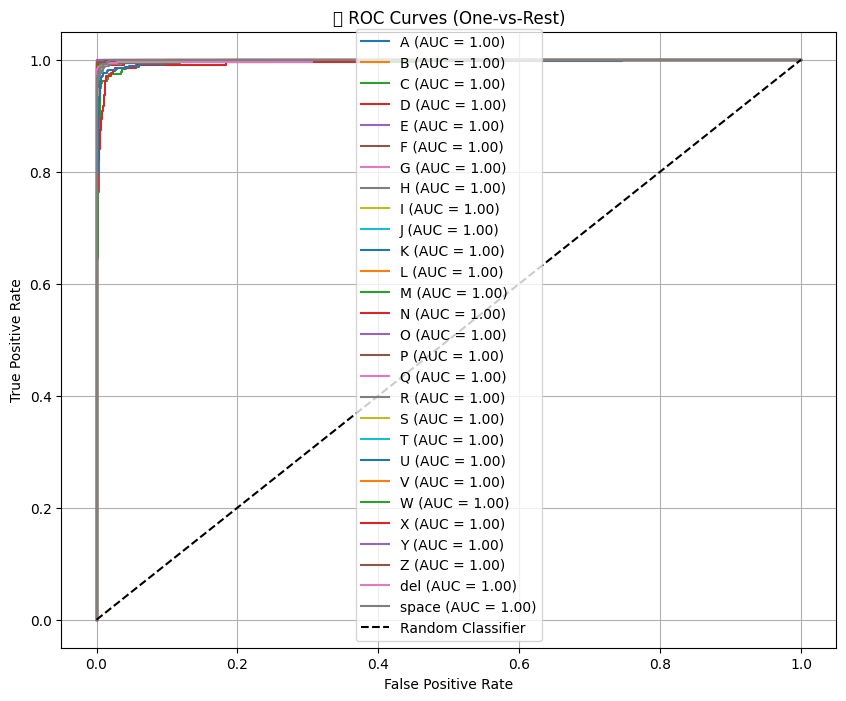

In [ ]:
# ROC Curve (One-vs-Rest)
y_test_bin = label_binarize(y_true_classes, classes=np.arange(len(encoder.classes_)))
fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(encoder.classes_)):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC Curves for all classes
plt.figure(figsize=(10, 8))
for i in range(len(encoder.classes_)):
    plt.plot(fpr[i], tpr[i], label=f'{encoder.classes_[i]} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier')
plt.title("ROC Curves (One-vs-Rest)")
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Confusion Matrix
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)
print("Confusion Matrix:\n", conf_matrix)

🧾 Confusion Matrix:
 [[415   0   0   0   0   1   0   0   0   0   0   0   3   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0 444   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0 347   0   0   0   0   0   0   0   0   0   1   0   1   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   2 435   0   1   0   0   0   0   0   0   0   0  13   0   0   0
    0   0   0   0   0   0   0   0   0   1]
 [  0   1   0   0 423   0   0   0   1   0   0   0   1   0   0   0   0   0
    8   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0 549   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   1   0   0   0   0   0   0   1]
 [  0   0   0   0   0   0 449   2   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   1 450   0   0   0   0   0   0   0   0   1   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   1   0   1   0 435   2  

Test Accuracy of the trained Model

In [9]:
model = tf.keras.models.load_model("asl_mediapipe_mlp_model.h5")

# Evaluate on test data
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

374/374 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9724 - loss: 0.1205
Test Accuracy: 97.20%


Testing the Mediapipe Approach for Sign Recognition

In [5]:
import tkinter as tk 
from tkinter import filedialog
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
import mediapipe as mp
from PIL import Image, ImageTk
import datetime
from collections import deque
import pyttsx3

# Load model and labels
mlp_model = tf.keras.models.load_model("asl_mediapipe_mlp_model.h5")
df = pd.read_csv("asl_mediapipe_keypoints_dataset.csv")
encoder = LabelEncoder()
encoder.fit(df["label"])

# Text-to-speech setup
engine = pyttsx3.init()
engine.setProperty('rate', 150)

# MediaPipe setup
mp_hands = mp.solutions.hands
mp_drawing = mp.solutions.drawing_utils
hands = mp_hands.Hands(min_detection_confidence=0.7, min_tracking_confidence=0.7)

# UI setup
root = tk.Tk()
root.title("ASL to Text Translator with Voice")
root.geometry("900x720")
root.configure(bg="#f0f0f0")

# Globals
predicted_sentence = ""
last_valid_label = ""
last_prediction_time = datetime.datetime.now()
PREDICTION_DELAY = 2.0
CONFIDENCE_THRESHOLD = 0.85
prediction_buffer = deque(maxlen=7)
cap = None

# Start screen
start_frame = tk.Frame(root, bg="#f0f0f0")
start_frame.pack(fill=tk.BOTH, expand=True)

tk.Label(start_frame, text="Welcome to ASL to Text Translator", font=("Helvetica", 24, "bold"),
         bg="#f0f0f0", fg="#333").pack(pady=60)

tk.Button(start_frame, text="Start Translating", font=("Helvetica", 16),
          bg="#4CAF50", fg="white", padx=20, pady=10, command=lambda: start_translation()).pack()

# Main frame
main_frame = tk.Frame(root, bg="#f0f0f0")

video_label = tk.Label(main_frame)
video_label.pack(pady=10)

# Current letter label
current_letter_var = tk.StringVar()
tk.Label(main_frame, textvariable=current_letter_var, font=("Helvetica", 18, "bold"),
         fg="#333", bg="#f0f0f0").pack(pady=5)

sentence_box = tk.Text(main_frame, wrap=tk.WORD, height=4, font=("Helvetica", 18),
                       bg="black", fg="white", width=70)
sentence_box.pack(pady=(0, 10))
sentence_box.configure(state="disabled")

# Button actions
def clear_text():
    global predicted_sentence
    predicted_sentence = ""
    sentence_box.configure(state="normal")
    sentence_box.delete(1.0, tk.END)
    sentence_box.configure(state="disabled")

def save_to_file():
    if not predicted_sentence:
        return
    file_path = filedialog.asksaveasfilename(defaultextension=".txt")
    if file_path:
        with open(file_path, "w") as file:
            file.write(predicted_sentence)

def quit_app():
    if cap and cap.isOpened():
        cap.release()
    cv2.destroyAllWindows()  # Close the ASL reference window
    root.destroy()

def speak(text):
    if text.strip():
        engine.say(text.strip())
        engine.runAndWait()

def start_translation():
    global cap
    start_frame.pack_forget()
    main_frame.pack(fill=tk.BOTH, expand=True)
    cap = cv2.VideoCapture(0)
    update_frame()

# Frame processing
def update_frame():
    global predicted_sentence, last_valid_label, last_prediction_time

    ret, frame = cap.read()
    if not ret:
        return

    frame = cv2.flip(frame, 1)
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = hands.process(rgb_frame)

    current_letter_var.set("Detecting...")

    if results.multi_hand_landmarks:
        for hand_landmarks, handedness in zip(results.multi_hand_landmarks, results.multi_handedness):
            mp_drawing.draw_landmarks(frame, hand_landmarks, mp_hands.HAND_CONNECTIONS)

            h, w, _ = frame.shape
            x_coords = [lm.x * w for lm in hand_landmarks.landmark]
            y_coords = [lm.y * h for lm in hand_landmarks.landmark]
            x_min, x_max = int(min(x_coords)) - 20, int(max(x_coords)) + 20
            y_min, y_max = int(min(y_coords)) - 20, int(max(y_coords)) + 20
            cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

            landmarks = np.array([[lm.x, lm.y, lm.z] for lm in hand_landmarks.landmark])
            if handedness.classification[0].label == "Right":
                landmarks[:, 0] = 1 - landmarks[:, 0]

            input_data = landmarks.flatten().reshape(1, -1)
            prediction = mlp_model.predict(input_data, verbose=0)
            predicted_class = np.argmax(prediction)
            confidence = prediction[0][predicted_class]

            if confidence > CONFIDENCE_THRESHOLD:
                predicted_label = encoder.inverse_transform([predicted_class])[0]
                current_letter_var.set(f"Current Letter: {predicted_label}")
                prediction_buffer.append(predicted_label)

                if prediction_buffer.count(predicted_label) >= 4:
                    current_time = datetime.datetime.now()
                    if predicted_label != last_valid_label or (current_time - last_prediction_time).total_seconds() > PREDICTION_DELAY:
                        if predicted_label == "space":
                            predicted_sentence += " "
                        elif predicted_label == "del":
                            predicted_sentence = predicted_sentence[:-1]
                        elif predicted_label != "nothing":
                            predicted_sentence += predicted_label

                        sentence_box.configure(state="normal")
                        sentence_box.delete(1.0, tk.END)
                        sentence_box.insert(tk.END, predicted_sentence)
                        sentence_box.configure(state="disabled")

                        last_valid_label = predicted_label
                        last_prediction_time = current_time

    display_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    img = Image.fromarray(display_frame)
    imgtk = ImageTk.PhotoImage(image=img)
    video_label.imgtk = imgtk
    video_label.configure(image=imgtk)

    root.after(10, update_frame)

# Button panel
btn_frame = tk.Frame(main_frame, bg="#f0f0f0")
btn_frame.pack(pady=10)

tk.Button(btn_frame, text="Clear All", command=clear_text, bg="#e6e6d2",
          width=15, font=("Helvetica", 12)).pack(side=tk.LEFT, padx=10)

tk.Button(btn_frame, text="Save to a Text File", command=save_to_file, bg="green", fg="white",
          width=20, font=("Helvetica", 12)).pack(side=tk.LEFT, padx=10)

tk.Button(btn_frame, text="Speak", command=lambda: speak(predicted_sentence),
          bg="#007ACC", fg="white", width=12, font=("Helvetica", 12)).pack(side=tk.LEFT, padx=10)

tk.Button(btn_frame, text="Quit", command=quit_app, bg="red", fg="white",
          width=10, font=("Helvetica", 12)).pack(side=tk.LEFT, padx=10)

# Show ASL.png in a persistent OpenCV window
asl_image = cv2.imread("ASL.png")
if asl_image is not None:
    asl_image = cv2.resize(asl_image, (675, 500))
    cv2.imshow("ASL Reference", asl_image)
else:
    print("ASL.png not found.")

# Run the app
root.mainloop()